# Destretching time-series images with FLCT

Ground-based observations of the sun suffer from atmospheric "seeing" distortions, which are typically non-uniform across the field of view; as such, even techniques such as adaptive optics or speckle reconstruction are not able to fully compensate. To remove any remaining distortions and enable analysis of, e.g., surface flows and sub-pixel localizations of small-scale features, the data must be destretched; that is, the distortions from the atmosphere must be undone.

To do this, we will use Fourier Local Correlation Tracking (FLCT). Essentially, we break up the image into subfields, and compare each subfield with its counterpart in a reference image. For each subfield, we compute the Fourier transform, and take the inner product with its reference counterpart. The product of the two Fourier transforms will have a global maximum at low spatial frequencies; if the subfield and its reference counterpart were perfectly aligned, that peak would be exactly at the origin. If the peak is offset, then the magnitude and direction of that offset is exactly the displacement of the subfield from the reference. Doing this for every subfield produces a vector map, which can be interpolated across the whole image; applying those shifts thus destretches the image to match the reference frame.

In [1]:
# Import necessary tools and functions.
from astropy.io import fits
from destretch import *
from matplotlib.animation import FuncAnimation
from IPython import display
pl.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'

In [2]:
# Get test data from FITS file.
Hdu = fits.open("test/test.fits")
test_data = Hdu[0].data
test_data /= np.mean(test_data)
med = np.median(test_data, axis=0)

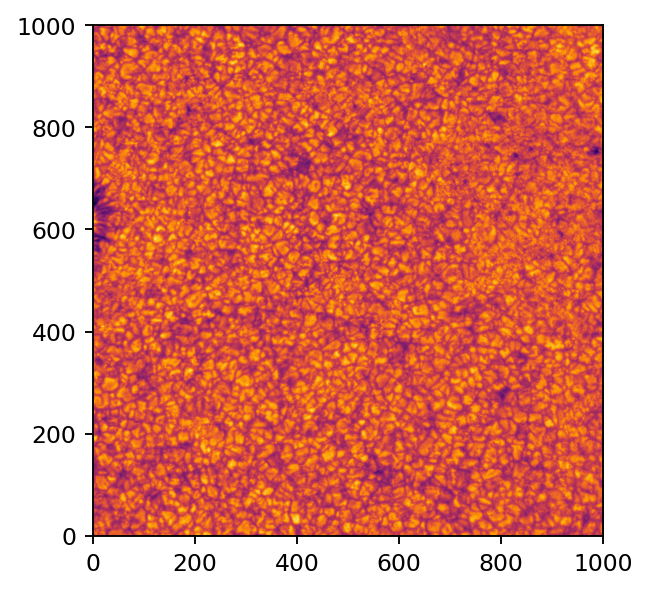

In [3]:
# Visualize test data as an animation.
fig = pl.figure(figsize=(5,4), dpi=169)
ax = pl.subplot(111)
im = pl.imshow(test_data[0], origin='lower', cmap='inferno')
title = ax.set_title('')
ax.set_xlim(0, 1000)
ax.set_ylim(0, 1000)

def draw(n):
    im.set_data(test_data[n])
    title.set_text(f'frame {n}')
    return im

anim = FuncAnimation(fig, draw, frames=11, interval=100)

In [4]:
# Display the animation as a JavaScript widget.
# Note how the image "jitters" from frame to frame; this is what we want to remove.
display.HTML(anim.to_jshtml())

In [18]:
# Perform destretching for each frame, using median as reference.
kernel_sizes = [100, 60, 20]
reference = np.median(test_data, axis=0)
#reference = test_data[5]
ans = np.zeros(test_data.shape)

for i in range(11):
    scene = test_data[i]
    ans[i], disp, rdisp, d_info = reg_loop(scene, reference, kernel_sizes)
#ans, disp, rdisp, d_info = reg_loop(test_data, reference, kernel_sizes)

Time for a scene destretch is 0.237
Total destr took: 0.23664 seconds for kernelof size 100 px.
Time for a scene destretch is 0.252
Total destr took: 0.25217 seconds for kernelof size 60 px.
Time for a scene destretch is 0.603
Total destr took: 0.60328 seconds for kernelof size 20 px.
Total elapsed time 2.3507 seconds.
Time for a scene destretch is 0.247
Total destr took: 0.24685 seconds for kernelof size 100 px.
Time for a scene destretch is 0.231
Total destr took: 0.23128 seconds for kernelof size 60 px.
Time for a scene destretch is 0.861
Total destr took: 0.86063 seconds for kernelof size 20 px.
Total elapsed time 2.8067 seconds.
Time for a scene destretch is 0.323
Total destr took: 0.32298 seconds for kernelof size 100 px.
Time for a scene destretch is 0.341
Total destr took: 0.34084 seconds for kernelof size 60 px.
Time for a scene destretch is 0.634
Total destr took: 0.63379 seconds for kernelof size 20 px.
Total elapsed time 2.8961 seconds.
Time for a scene destretch is 0.234
T

In [21]:
#pl.figure(figsize=(10,10))
#d = disp - rdisp
#pl.imshow(np.sqrt(d[0]**2 + d[1]**2), origin='lower', cmap='inferno', interpolation='bicubic')
#pl.colorbar()
rdisp

array([[[ 20.,  20.,  20., ...,  20.,  20.,  20.],
        [ 40.,  40.,  40., ...,  40.,  40.,  40.],
        [ 60.,  60.,  60., ...,  60.,  60.,  60.],
        ...,
        [940., 940., 940., ..., 940., 940., 940.],
        [960., 960., 960., ..., 960., 960., 960.],
        [980., 980., 980., ..., 980., 980., 980.]],

       [[ 20.,  40.,  60., ..., 940., 960., 980.],
        [ 20.,  40.,  60., ..., 940., 960., 980.],
        [ 20.,  40.,  60., ..., 940., 960., 980.],
        ...,
        [ 20.,  40.,  60., ..., 940., 960., 980.],
        [ 20.,  40.,  60., ..., 940., 960., 980.],
        [ 20.,  40.,  60., ..., 940., 960., 980.]]])

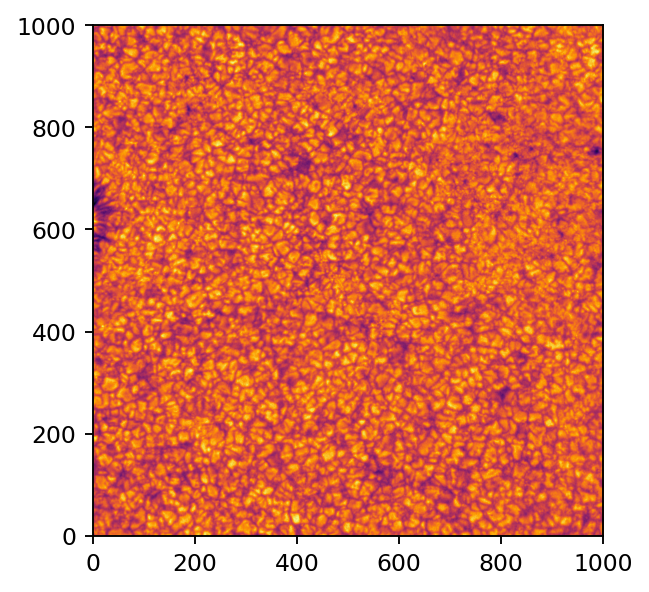

In [7]:
# Create another animation to visualize the destretched data.
fig = pl.figure(figsize=(5,4), dpi=169)
ax = pl.subplot(111)
im = pl.imshow(ans[0], origin='lower', cmap='inferno')
title = ax.set_title('')
ax.set_xlim(0, 1000)
ax.set_ylim(0, 1000)

def draw(n):
    im.set_data(ans[n])
    title.set_text(f'frame {n}')
    return im

anim = FuncAnimation(fig, draw, frames=11, interval=100)

In [8]:
# Once again, we display the animation as a JS widget.
# The "jitter" has been greatly reduced, but some small-scale distortions remain.
display.HTML(anim.to_jshtml())

Time for a scene destretch is 0.388
Total destr took: 0.38820 seconds for kernelof size 30 px.
Total elapsed time 0.8548 seconds.


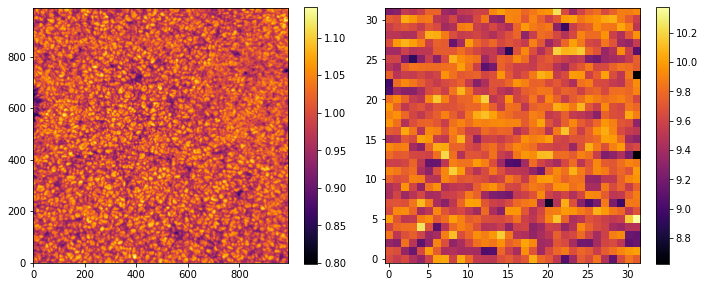

In [267]:
scene = ((med - 0) + (np.random.rand(1000,1000) - 0.5)*0.)[:-10, 5:-5]
ref = ((med - 0) + (np.random.rand(1000,1000) - 0.5)*0.)[10:, 5:-5]
kernel = [30]

ans, disp, rdisp, d_info = reg_loop(scene, ref, kernel)

d = disp - rdisp
pl.figure(figsize=(10, 4))
pl.subplot(121)
pl.imshow(ans, origin='lower', cmap='inferno')
pl.colorbar()
pl.subplot(122)
pl.imshow(np.sqrt(d[0]**2 + d[1]**2), origin='lower', cmap='inferno')
pl.colorbar()
pl.tight_layout()

(array([ 2.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  2.,  0.,  0.,  1.,  1.,  1.,  0.,  1.,  3.,  2.,  2.,
         4.,  0.,  3.,  4.,  2.,  4.,  1.,  4.,  4.,  1.,  3.,  8.,  8.,
         6., 11.,  7.,  8., 12., 14., 15., 17., 13., 10., 22., 30., 24.,
        18., 28., 33., 28., 25., 40., 28., 27., 24., 33., 30., 24., 29.,
        38., 26., 30., 36., 25., 26., 33., 33., 19., 24., 10., 17., 18.,
        14., 11.,  6., 10.,  7.,  5.,  3.,  2.,  3.,  2.,  3.,  1.,  1.,
         0.,  1.,  1.,  0.,  0.,  0.,  0.,  0.,  1.]),
 array([ 8.6266918 ,  8.64418795,  8.66168409,  8.67918024,  8.69667639,
         8.71417253,  8.73166868,  8.74916483,  8.76666098,  8.78415712,
         8.80165327,  8.81914942,  8.83664557,  8.85414171,  8.87163786,
         8.88913401,  8.90663016,  8.9241263 ,  8.94162245,  8.9591186 ,
         8.97661474,  8.99411089,  9.01160704,  9.02910319,  9.04659933,
         9.06409548,  9.08159163,  9.09908778,  9.11658392,  9.134080

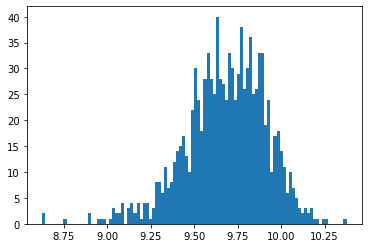

In [268]:
pl.hist(np.sqrt(d[0]**2 + d[1]**2).ravel(), bins=100)

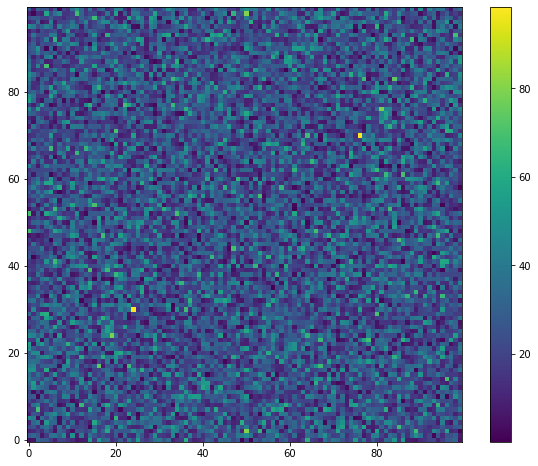

In [269]:
pl.figure(figsize=(10, 8))
noise = np.random.rand(100,100) - 0.5
noise_fft = np.fft.fftshift(np.fft.fft2(noise))
pl.imshow(np.abs(noise_fft), origin='lower')
pl.colorbar()

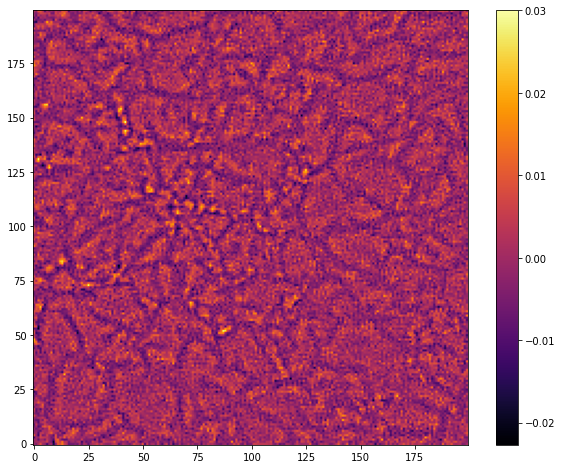

In [277]:
from scipy.signal import wiener
pl.figure(figsize=(10,8))
pl.imshow((scene*1 - 1*wiener(scene, 3))[400:600, 400:600], origin='lower', cmap='inferno')
pl.colorbar()

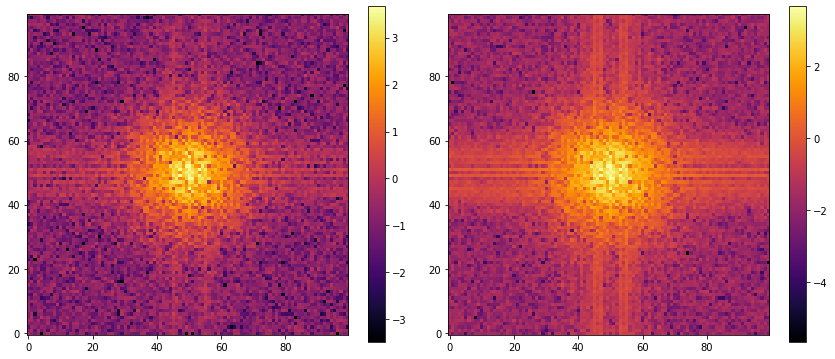

In [264]:
sf = np.fft.fftshift(np.fft.fft2(scene[450:550, 450:550] - 1))
swf = np.fft.fftshift(np.fft.fft2(wiener(scene[450:550, 450:550] - 1, 3)))
pl.figure(figsize=(12, 5))
pl.subplot(121)
pl.imshow(np.log10(np.abs(sf*sf.conj())), origin='lower', cmap='inferno')
pl.colorbar()
pl.subplot(122)
pl.imshow(np.log10(np.abs(swf*swf.conj())), origin='lower', cmap='inferno')
pl.colorbar()
pl.tight_layout()